## Notebook for MiniRF data analysis
Author: Michal Glos (213396)
Diploma Thesis

### Setup environment
 - Since we use our tools in jupyter, certain key configurations have to be adjusted
 - Add source code location for imports to work (relative '..', absolute path might be necessary)
 - Configure the "HDD" path - the main folder used for SPICE and dataset caching

In [36]:
import sys
sys.path.insert(0, '..')

import os
import gc
import logging
from concurrent.futures import ProcessPoolExecutor, as_completed

import src.global_config as global_config
global_config.HDD_BASE_PATH = ...
global_config.SUPRESS_TQDM = False

import src.db.config as db_config
db_config.MONGO_URI = ...

import numpy as np
import pandas as pd
import pyarrow as pa
import pyarrow.parquet as pq
from tqdm import tqdm
from pymongo import MongoClient

logger = logging.getLogger(__name__)

from src.db.interface import Sessions
from src.SPICE.config import TIF_SAMPLE_RATE, root_path
from src.SPICE.kernel_utils.detailed_model import DetailedModelDSKKernel
# jupyter notebook --ip=192.168.191.152 --port=8888 --no-browser

### Basic data visualization for sanity check

In [37]:
%%time 

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools

collection = Sessions.get_extraction_collection("DIVINER")
dsk_filename = f"custom_lunar_model_{TIF_SAMPLE_RATE:.4}".replace(".", "_") + ".dsk"
detailed_lunar_model_kernel = DetailedModelDSKKernel(root_path(dsk_filename), tif_sample_rate=TIF_SAMPLE_RATE)
lunar_pit_collection, *_ = Sessions.get_lunar_pit_collections()

# Get pits and compute Cartesian coordinates
pits = lunar_pit_collection.find({}).to_list()
lats, lons = np.array([p['location']['coordinates'][::-1] for p in pits]).T
for pit, location in zip(pits, detailed_lunar_model_kernel.latlon_to_cartesian(lats, lons)):
    pit['safe_name'] = pit['name'].replace(" ", "_")
    pit['location']['cartesian'] = location

# Select target pit
target_pit = next((p for p in pits if p['inner_max_diameter'] == 305), None)
px, py, pz = target_pit['location']['cartesian'] if target_pit else (0, 0, 0)

radii = 10
query = {
    "cx_projected": {"$gte": px - radii, "$lte": px + radii},
    "cy_projected": {"$gte": py - radii, "$lte": py + radii},
    "cz_projected": {"$gte": pz - radii, "$lte": pz + radii},
    "c": {"$gte": 5, "$lte": 7},
    "tb": {"$gt":10, "$lt": 500},
    "qmi": 0,
    "qca": 0,
}

projection = {
    "cx_projected": 1,
    "cy_projected": 1,
    "cz_projected": 1,
    "meta": 1,
    "c": 1,
    "det": 1,
    "cloctime": 1,
    "tb": 1,
}

results = collection.find(query, projection=projection).to_list()
df = pd.DataFrame.from_records(results)
df['et'] = df['meta'].apply(lambda x: x['et'])

CPU times: user 7.7 s, sys: 1.26 s, total: 8.96 s
Wall time: 30.2 s


In [2]:
def plot_diviner_temperature_summary(df, detectors=[5, 6, 7], time_bin_size=0.1):
    # Filter usable data
    df = df[(df['tb'] > 0) & (df['det'].isin(detectors))].copy()

    # Time binning using defined bin size
    df['time_bin'] = (df['cloctime'] / time_bin_size).round().astype(int) * time_bin_size

    # Calculate mean and median TB per time bin
    stats = df.groupby('time_bin')['tb'].agg(['mean']).reset_index()
    stats_long = stats.melt(id_vars='time_bin', var_name='stat', value_name='tb')

    # Plot
    sns.set_theme(style="whitegrid", context="talk")
    fig, ax = plt.subplots(figsize=(10, 6))

    # Raw scatter data (faint)
    sns.scatterplot(data=df, x='cloctime', y='tb', alpha=0.55, s=22, ax=ax, label='Raw TB')

    # Mean & Median lines
    sns.lineplot(
        data=stats_long, x='time_bin', y='tb', hue='stat',
        ax=ax, linewidth=3.3, palette={'mean': '#ff7f0e'}
    )

    # Labels
    ax.set_title(f"Brightness Temperature vs Local Time (Detectors {min(detectors)+1}–{max(detectors)+1})")
    ax.set_xlabel("Local Time (h)")
    ax.set_ylabel("Brightness Temperature (K)")
    ax.legend(title="Statistic")
    ax.grid(True, linestyle='--', alpha=0.5)

    plt.tight_layout()

    plt.savefig("showing_diviner_data.png", dpi=400, bbox_inches='tight')
    plt.show()


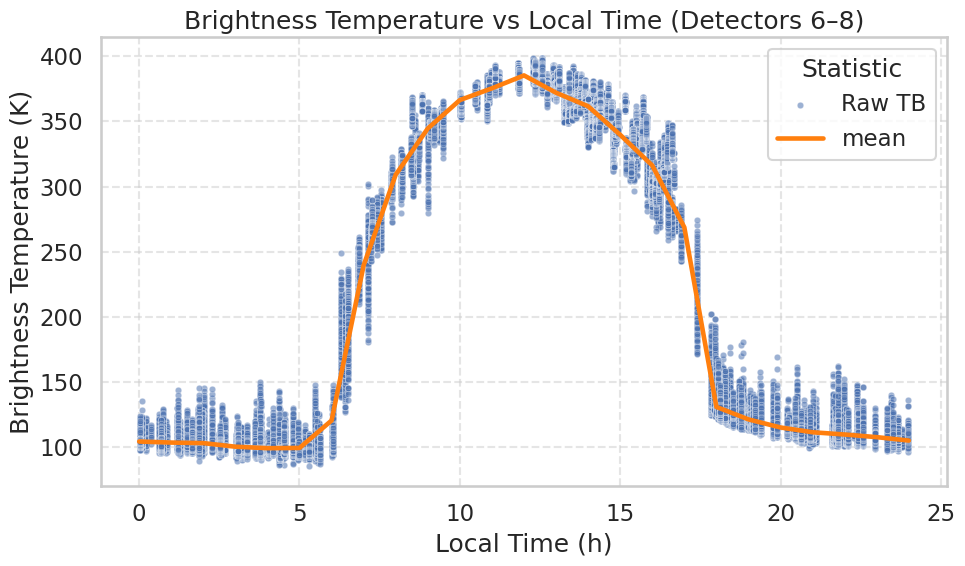

In [4]:
plot_diviner_temperature_summary(df, time_bin_size=1)

^^^ This looks like what we would expect

### For more detailed examination, let's plot the data in 3D space, employind interactive slider to view data for particular time of the lunar day

In [49]:
def plot_3d_temporal_slider(df, detectors=[5, 6, 7], time_bin=0.5, point=None):
    import plotly.express as px
    import plotly.graph_objects as go
    import numpy as np

    df = df[(df['tb'] > 0) & (df['c'].isin(detectors))].copy()

    # Time binning
    df['time_bin'] = (df['cloctime'] / time_bin).round() * time_bin
    df['time_bin_float'] = df['time_bin']
    df['time_bin'] = df['time_bin'].map(lambda x: f"{x:.2f}")
    df = df.sort_values('time_bin_float')

    # Bounding box + unit-normalized cube size
    x_min, x_max = df['cx_projected'].min(), df['cx_projected'].max()
    y_min, y_max = df['cy_projected'].min(), df['cy_projected'].max()
    z_min, z_max = df['cz_projected'].min(), df['cz_projected'].max()

    # Compute unified axis span
    max_range = max(x_max - x_min, y_max - y_min, z_max - z_min)
    center_x = (x_max + x_min) / 2
    center_y = (y_max + y_min) / 2
    center_z = (z_max + z_min) / 2

    half_span = max_range / 2
    x_range = [center_x - half_span, center_x + half_span]
    y_range = [center_y - half_span, center_y + half_span]
    z_range = [center_z - half_span, center_z + half_span]

    tb_range = [df['tb'].min(), df['tb'].max()]

    fig = px.scatter_3d(
        df,
        x='cx_projected', y='cy_projected', z='cz_projected',
        color='tb',
        animation_frame='time_bin',
        range_color=tb_range,
        color_continuous_scale='viridis',
        #title='3D Diviner Points',
        labels={'tb': 'Brightness Temp (K)'},
        opacity=1
    )
    fig.update_traces(marker=dict(size=2))
    if point is not None:
        fig.add_trace(go.Scatter3d(
            x=[point[0]], y=[point[1]], z=[point[2]],
            mode='markers',
            marker=dict(size=8, color='black'),
            showlegend=False
        ))
    
    

    # Force cubic aspect + fixed axis bounds
    scene_fixed = dict(
        xaxis=dict(title='X', range=x_range),
        yaxis=dict(title='Y', range=y_range),
        zaxis=dict(title='Z', range=z_range),
        aspectmode='manual',
        aspectratio=dict(x=1, y=1, z=1)
    )

    fig.update_layout(
        #scene=scene_fixed,
        margin=dict(l=18, r=18, b=18, t=30),
        coloraxis_colorbar=dict(
            title="TB (K)",
            #titlefont=dict(size=18),
            tickfont=dict(size=16)
        ),
        width=700,
        height=700,
        scene=dict(
            xaxis=dict(title='X', range=x_range, tickfont=dict(size=14)),
            yaxis=dict(title='Y', range=y_range, tickfont=dict(size=14)),
            zaxis=dict(title='Z', range=z_range, tickfont=dict(size=14)),
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1)
        ),
        font=dict(size=16)  # global fallback
    )

    for frame in fig.frames:
        frame.layout.scene = scene_fixed

    fig.write_image("3D_plot.png", width=1600, height=800, scale=3)
    fig.show()


In [ ]:
plot_3d_temporal_slider(df, time_bin=2)

### Now we specifically look for the thermal outliers to indicate the presence of lunar pit and it's cavities underneath

In [ ]:
%%time 
from tqdm.notebook import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools

collection = Sessions.get_extraction_collection("DIVINER")
dsk_filename = f"custom_lunar_model_{TIF_SAMPLE_RATE:.4}".replace(".", "_") + ".dsk"
detailed_lunar_model_kernel = DetailedModelDSKKernel(root_path(dsk_filename), tif_sample_rate=TIF_SAMPLE_RATE)
lunar_pit_collection, *_ = Sessions.get_lunar_pit_collections()

# Get pits and compute Cartesian coordinates
pits = lunar_pit_collection.find({}).to_list()
lats, lons = np.array([p['location']['coordinates'][::-1] for p in pits]).T
for pit, location in zip(pits, detailed_lunar_model_kernel.latlon_to_cartesian(lats, lons)):
    pit['safe_name'] = pit['name'].replace(" ", "_")
    pit['location']['cartesian'] = location

dataframes = []

for pit in tqdm(pits, desc="Looking for lunar pit anomalies", ncols=1000):
    px, py, pz = pit['location']['cartesian']
    radii = 10
    query = {
        "cx_projected": {"$gte": px - radii, "$lte": px + radii},
        "cy_projected": {"$gte": py - radii, "$lte": py + radii},
        "cz_projected": {"$gte": pz - radii, "$lte": pz + radii},
        "c": {"$gte": 5, "$lte": 7},
        "tb": {"$gt":200, "$lt": 500},
        "qmi": 0,
        "qca": 0,
        "$or": [
            {"cloctime": {"$lte": 5.5, "$gte": 0}},
            {"cloctime": {"$lte": 24, "$gte": 18}}
        ]
    }

    projection = {
        "cx_projected": 1,
        "cy_projected": 1,
        "cz_projected": 1,
        "meta": 1,
        "c": 1,
        "det": 1,
        "cloctime": 1,
        "tb": 1,
    }

    results = collection.find(query, projection=projection).to_list()

    if not results:
        dataframes.append((pit, None))
        continue

    df = pd.DataFrame.from_records(results)
    df['et'] = df['meta'].apply(lambda x: x['et'])
    dataframes.append((pit, df))

### Search in the 5 KM radius circle around each lunar pit for temperaturee anomalies, aggregate temperature statistics

In [39]:
new_radius = 5

new_dataframes = []
new_pits = []

for _pit, _df in dataframes:
    if _df is None:
        continue
    pit_location = _pit['location']['cartesian'][:, None]
    pointcloud_locations = _df[["cx_projected", "cy_projected", "cz_projected"]].values.T - pit_location
    _df['distance_from_pit'] = np.linalg.norm(pointcloud_locations, axis=0)
    _df = _df[(_df['distance_from_pit'] <= new_radius)]
    
    new_dataframes.append(_df)
    new_pits.append(_pit)

_dataframes = [_df[1] for _df in dataframes if _df[1] is not None]
lengths = [len(d.values) for d in _dataframes]
ultraframe = pd.concat(new_dataframes)

### Plot the statistics about the thermal anomalies measured

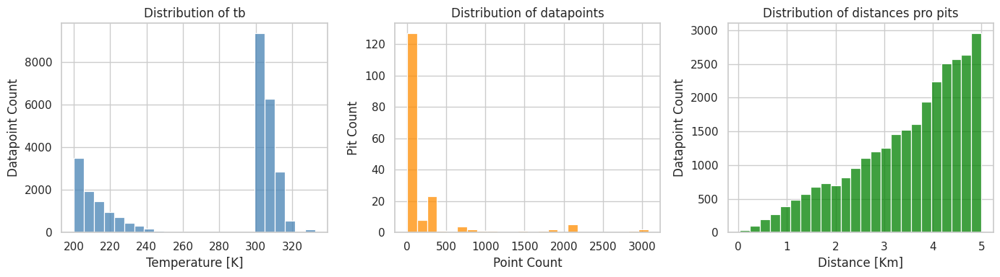

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Use seaborn style for better aesthetics
sns.set(style='whitegrid')

# Create figure and axes
fig, axes = plt.subplots(1, 3, figsize=(14, 4))

# First histogram
sns.histplot(ultraframe['tb'], bins=24, kde=False, ax=axes[0], color='steelblue')
axes[0].set_title('Distribution of tb')
axes[0].set_xlabel('Temperature [K]')
axes[0].set_ylabel('Datapoint Count')

# Second histogram
sns.histplot(pd.Series(lengths), bins=24, kde=False, ax=axes[1], color='darkorange')
axes[1].set_title('Distribution of datapoints')
axes[1].set_xlabel('Point Count')
axes[1].set_ylabel('Pit Count')

sns.histplot(ultraframe['distance_from_pit'], bins=24, kde=False, ax=axes[2], color='green')
axes[2].set_title("Distribution of distances pro pits")
axes[2].set_xlabel("Distance [Km]")
axes[2].set_ylabel("Datapoint Count")

plt.tight_layout()
plt.savefig("200_plus_datapoints.png", dpi=400, bbox_inches='tight')
plt.show()

### W

In [ ]:
_new_dataframes_higher_t = [_df[_df['tb'] > 250] for _df in new_dataframes]
_new_pits = [pit for pit, _df in zip(new_pits, _new_dataframes_higher_t) if not _df.empty]
new_dataframes_higher_t = [_df for _df in _new_dataframes_higher_t if not _df.empty]
new_dataframes_higher_t_df = pd.concat(new_dataframes_higher_t)

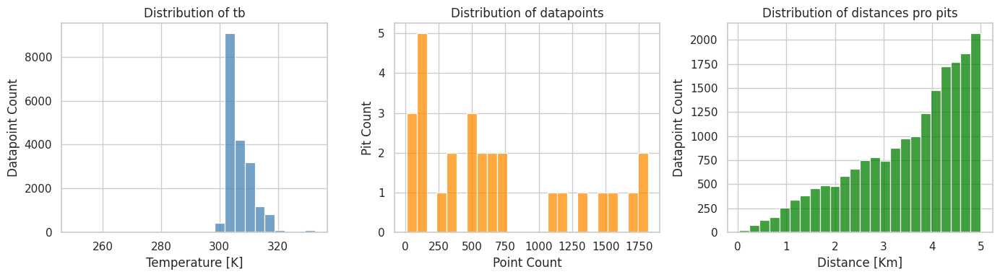

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Use seaborn style for better aesthetics
sns.set(style='whitegrid')

# Create figure and axes
fig, axes = plt.subplots(1, 3, figsize=(14, 4))

# First histogram
sns.histplot(new_dataframes_higher_t_df['tb'], bins=24, kde=False, ax=axes[0], color='steelblue')
axes[0].set_title('Distribution of tb')
axes[0].set_xlabel('Temperature [K]')
axes[0].set_ylabel('Datapoint Count')

# Second histogram
sns.histplot(pd.Series([len(d.values) for d in new_dataframes_higher_t]), bins=24, kde=False, ax=axes[1], color='darkorange')
axes[1].set_title('Distribution of datapoints')
axes[1].set_xlabel('Point Count')
axes[1].set_ylabel('Pit Count')

sns.histplot(new_dataframes_higher_t_df['distance_from_pit'], bins=24, kde=False, ax=axes[2], color='green')
axes[2].set_title("Distribution of distances pro pits")
axes[2].set_xlabel("Distance [Km]")
axes[2].set_ylabel("Datapoint Count")

plt.tight_layout()
plt.savefig("250_plus_datapoints.png", dpi=400, bbox_inches='tight')
plt.show()

In [32]:
plot_3d_temporal_slider(new_dataframes_higher_t[22], detectors=[5, 6, 7], time_bin=1, point=_new_pits[22]['location']['cartesian'])

In [27]:
plot_3d_temporal_slider(df[df["tb"] < 250], detectors=[5], time_bin=0.1, point=_new_pits[22]['location']['cartesian'])

In [27]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np

def plot_3d_compare_oriented(
    df1, df2,
    detectors1=[5,6,7], detectors2=[5,6,7],
    point1=None, point2=None,
    dist_factor=0.6,
    orthographic=True,
    output_filename='plot_compare.png'
):
    # filter & PCA‐normal
    df1 = df1[(df1.tb>0)&(df1.c.isin(detectors1))].copy()
    df2 = df2[(df2.tb>0)&(df2.c.isin(detectors2))].copy()
    pts = np.vstack([
        df1[['cx_projected','cy_projected','cz_projected']],
        df2[['cx_projected','cy_projected','cz_projected']]
    ])
    cov = np.cov(pts - pts.mean(0), rowvar=False)
    _, eigvecs = np.linalg.eigh(cov)
    normal = eigvecs[:, 0]
    if normal[2] < 0: normal = -normal
    normal /= np.linalg.norm(normal)

    # camera
    center = pts.mean(0)
    span   = pts.ptp(0).max()
    eye = dict(
        x=center[0] + normal[0]*span*dist_factor,
        y=center[1] + normal[1]*span*dist_factor,
        z=center[2] + normal[2]*span*dist_factor
    )

    # cube ranges & annotation positions
    half = span/2
    xr = [center[0]-half, center[0]+half]
    yr = [center[1]-half, center[1]+half]
    zr = [center[2]-half, center[2]+half]

    tb_min = min(df1.tb.min(), df2.tb.min())
    tb_max = max(df1.tb.max(), df2.tb.max())

    cam = dict(eye=eye)
    if orthographic:
        cam['projection'] = dict(type='orthographic')

    # 3D annotations for axis ends
    annots = [
        dict(x=xr[1], y=center[1], z=center[2],
             text='X', showarrow=False, font=dict(size=26),
             xanchor='left'),
        dict(x=center[0], y=yr[1], z=center[2],
             text='Y', showarrow=False, font=dict(size=26),
             xanchor='left'),
        dict(x=center[0], y=center[1], z=zr[1],
             text='Z', showarrow=False, font=dict(size=26),
             xanchor='left'),
    ]

    scene = dict(
        xaxis=dict(range=xr, tickfont=dict(size=14), title=""),
        yaxis=dict(range=yr, tickfont=dict(size=14), title="Y"),
        zaxis=dict(range=zr, tickfont=dict(size=14), title="Z"),
        aspectmode='manual', aspectratio=dict(x=1,y=1,z=1),
        camera=cam,
        #annotations=annots
    )

    fig = make_subplots(
        rows=1, cols=2,
        specs=[[{'type':'scene'},{'type':'scene'}]],
        horizontal_spacing=0.02
    )

    for df, pt, r, c in [(df1, point1,1,1),(df2, point2,1,2)]:
        fig.add_trace(
            go.Scatter3d(
                x=df.cx_projected, y=df.cy_projected, z=df.cz_projected,
                mode='markers',
                marker=dict(size=2, color=df.tb, coloraxis='coloraxis'),
                showlegend=False
            ), row=r, col=c
        )
        if pt is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=[pt[0]], y=[pt[1]], z=[pt[2]],
                    mode='markers', marker=dict(size=8, color='black'),
                    showlegend=False
                ), row=r, col=c
            )

    fig.update_layout(
        showlegend=False,
        coloraxis=dict(
            colorscale='Viridis', cmin=tb_min, cmax=tb_max,
            colorbar=dict(
                title='TB (K)', tickfont=dict(size=25),
                x=0.5, xanchor='center', len=0.75
            )
        ),
        scene=scene, scene2=scene,
        font=dict(size=26),
        width=1600, height=800,
        margin=dict(l=5, r=5, t=5, b=5)
    )

    # export PNG at ~288 DPI
    fig.write_image(output_filename, width=1600, height=800, scale=3)
    fig.show()


In [29]:
df1 = __df[(__df["tb"] < 250) & (__df['cloctime'] <= 1.1) & (__df['cloctime'] >= 1)]
df2 = new_dataframes_higher_t[22]
detectors1 = [5]
detectors2 = [5]
point = _new_pits[22]['location']['cartesian']

plot_3d_compare_oriented(df1, df2, detectors1=detectors1, detectors2=detectors2, point1=point, point2=point)

<Axes: >

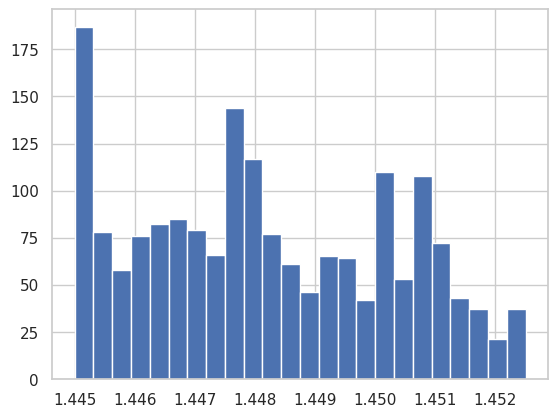

In [160]:
#(new_dataframes_higher_t[22]['et'] - new_dataframes_higher_t[22]['et'].min()).hist(bins=24)
new_dataframes_higher_t[22]['cloctime'].hist(bins=24)

In [42]:
%%time

# Select target pit
target_pit = next((p for p in pits if p['inner_max_diameter'] == 305), None)
px, py, pz = np.array([1572.59226562,  722.86940454,  125.39355866])

radii = 10
query = {
    "cx_projected": {"$gte": px - radii, "$lte": px + radii},
    "cy_projected": {"$gte": py - radii, "$lte": py + radii},
    "cz_projected": {"$gte": pz - radii, "$lte": pz + radii},
    "c": {"$gte": 5, "$lte": 7},
    "tb": {"$gt":10, "$lt": 500},
    "qmi": 0,
    "qca": 0,
}

projection = {
    "cx_projected": 1,
    "cy_projected": 1,
    "cz_projected": 1,
    "meta": 1,
    "c": 1,
    "det": 1,
    "cloctime": 1,
    "tb": 1,
}

results = collection.find(query, projection=projection).to_list()
__df = pd.DataFrame.from_records(results)
__df['et'] = df['meta'].apply(lambda x: x['et'])

CPU times: user 9.21 s, sys: 5.26 s, total: 14.5 s
Wall time: 14.4 s


### This temperature map checks out with the craters position in LROC Atlas
https://lroc.im-ldi.com/data/support/pits/images/5/Southwest_Mare_Tranquillitatis_B_Pit_shaded_relief.png

In [50]:
plot_3d_temporal_slider(__df[__df["tb"] < 250], detectors=[5,6,7], time_bin=12, point= np.array([1573,  722.86940454,  125.39355866]))

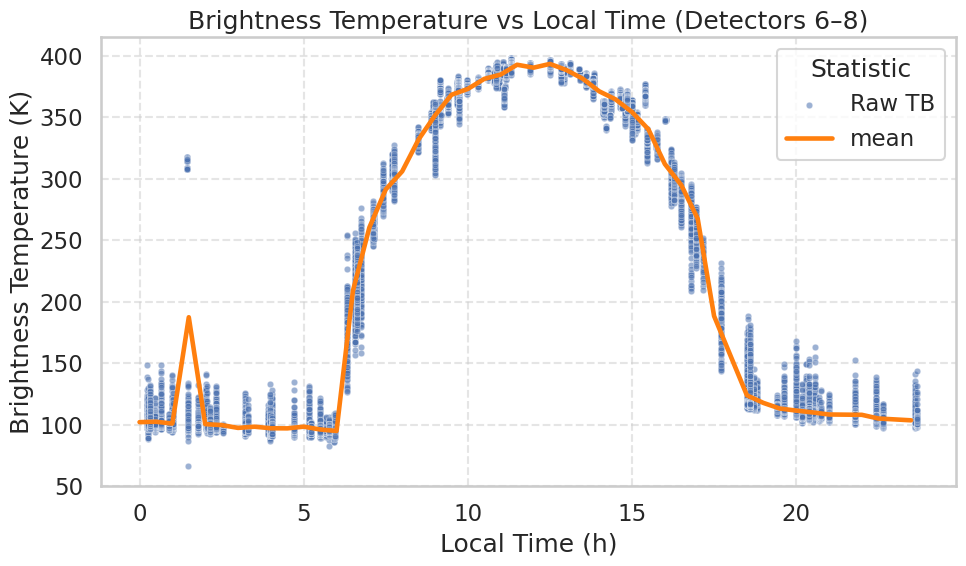

In [54]:
plot_diviner_temperature_summary(df, detectors=[5, 6, 7], time_bin_size=0.5)

In [170]:
df.describe()

,cz_projected,cy_projected,det,cloctime,c,tb,cx_projected,et
count,255974.000000,255974.000000,255974.000000,255974.000000,255974.000000,255974.000000,255974.000000,2.559740e+05
mean,125.384544,723.151236,10.077367,11.437744,6.026436,223.600527,1572.442284,5.272397e+08
std,2.528789,2.173856,5.913667,6.773722,0.822421,123.417600,1.017395,1.351858e+08
min,120.399210,718.315448,0.000000,0.040280,5.000000,66.559000,1570.480009,3.018033e+08
25%,123.325213,721.488838,5.000000,5.770830,5.000000,101.709000,1571.641758,4.032105e+08
50%,125.369196,723.336464,10.000000,11.174170,6.000000,198.197500,1572.356187,5.233110e+08
75%,127.446457,724.841875,15.000000,16.794450,7.000000,359.898750,1573.221255,6.655287e+08
max,130.381494,727.428947,20.000000,23.868330,7.000000,439.694000,1574.690316,7.511649e+08


In [2]:
%%time 
from tqdm.notebook import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools

collection = Sessions.get_extraction_collection("DIVINER")
dsk_filename = f"custom_lunar_model_{TIF_SAMPLE_RATE:.4}".replace(".", "_") + ".dsk"
detailed_lunar_model_kernel = DetailedModelDSKKernel(root_path(dsk_filename), tif_sample_rate=TIF_SAMPLE_RATE)
lunar_pit_collection, *_ = Sessions.get_lunar_pit_collections()

# Get pits and compute Cartesian coordinates
pits = lunar_pit_collection.find({}).to_list()
lats, lons = np.array([p['location']['coordinates'][::-1] for p in pits]).T
for pit, location in zip(pits, detailed_lunar_model_kernel.latlon_to_cartesian(lats, lons)):
    pit['safe_name'] = pit['name'].replace(" ", "_")
    pit['location']['cartesian'] = location

dataframes_within = []
dataframes_outside = []

for pit in tqdm(pits, desc="Looking for lunar pit anomalies", ncols=1000):
    px, py, pz = pit['location']['cartesian']
    radii = 3
    query = {
        "cx_projected": {"$gte": px - radii, "$lte": px + radii},
        "cy_projected": {"$gte": py - radii, "$lte": py + radii},
        "cz_projected": {"$gte": pz - radii, "$lte": pz + radii},
        "c": {"$gte": 5, "$lte": 7},
        "tb": {"$gt":10, "$lt": 500},
        "qmi": 0,
        "qca": 0,
        "$or": [
            {"cloctime": {"$lte": 5.5, "$gte": 0}},
            {"cloctime": {"$lte": 24, "$gte": 18}}
        ]
    }

    projection = {
        "cx_projected": 1,
        "cy_projected": 1,
        "cz_projected": 1,
        #"c": 1,
        #"det": 1,
        "cloctime": 1,
        "tb": 1,
    }

    results = collection.find(query, projection=projection).to_list()

    if not results:
        continue

    df = pd.DataFrame.from_records(results)

    dataframes_outside.append(df)
    pointcloud_locations = df[["cx_projected", "cy_projected", "cz_projected"]].values.T - pit['location']['cartesian'][:, None]
    df['distance_from_pit'] = np.linalg.norm(pointcloud_locations, axis=0)
    dataframes_within.append(df[(df['distance_from_pit'] <= 0.1)])


Looking for lunar pit anomalies:   0%|                                                                        …

CPU times: user 1min 41s, sys: 3.56 s, total: 1min 44s
Wall time: 17min 13s


In [3]:
_df_within = pd.concat(dataframes_within)
_df_outside = pd.concat(dataframes_outside)

In [6]:
_df_within['tb'].describe()

count    24097.000000
mean       112.609075
std         13.882606
min         52.740000
25%        102.803000
50%        110.532000
75%        120.109000
max        311.554000
Name: tb, dtype: float64

In [7]:
_df_outside['tb'].describe()

count    3.193347e+07
mean     1.137648e+02
std      1.463848e+01
min      3.655600e+01
25%      1.031010e+02
50%      1.115290e+02
75%      1.217720e+02
max      3.327120e+02
Name: tb, dtype: float64

In [40]:
dataframes_outside[0].columns

Index(['tb', 'cx_projected', '_id', 'cz_projected', 'cy_projected', 'cloctime',
       'distance_from_pit'],
      dtype='object')

In [41]:
pd.concat([dd[dd['distance_from_pit'] <= 0.01] for dd in dataframes_outside])['tb'].describe()

count    255.000000
mean     113.829020
std       13.769965
min       79.967000
25%      103.324500
50%      112.146000
75%      121.468000
max      162.644000
Name: tb, dtype: float64

In [42]:
pd.concat([dd[dd['distance_from_pit'] <= 0.025] for dd in dataframes_outside])['tb'].describe()

count    1547.000000
mean      112.972250
std        13.039276
min        73.524000
25%       103.122500
50%       111.092000
75%       120.177500
max       184.220000
Name: tb, dtype: float64